2MASXJ07001137-6602251.fits
2MIG_1546.fits
3C029.fits
AM2353-291.fits
ARP256.fits
ASASSN-13an.fits


/tmp/ipykernel_7889/722581573.py:70: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(3, 3, figsize=(16,10))


ASASSN-13ch.fits
ASASSN-13cj.fits
ASASSN-13cp.fits
ASASSN-13dd.fits
ASASSN-14at.fits
ASASSN-14az.fits
ASASSN-14ba.fits
ASASSN-14bf.fits
ASASSN-14co.fits
ASASSN-14db.fits
ASASSN-14dz.fits
ASASSN-14eu_B.fits
ASASSN-14fa.fits
ASASSN-14ig.fits
ASASSN-14jg.fits


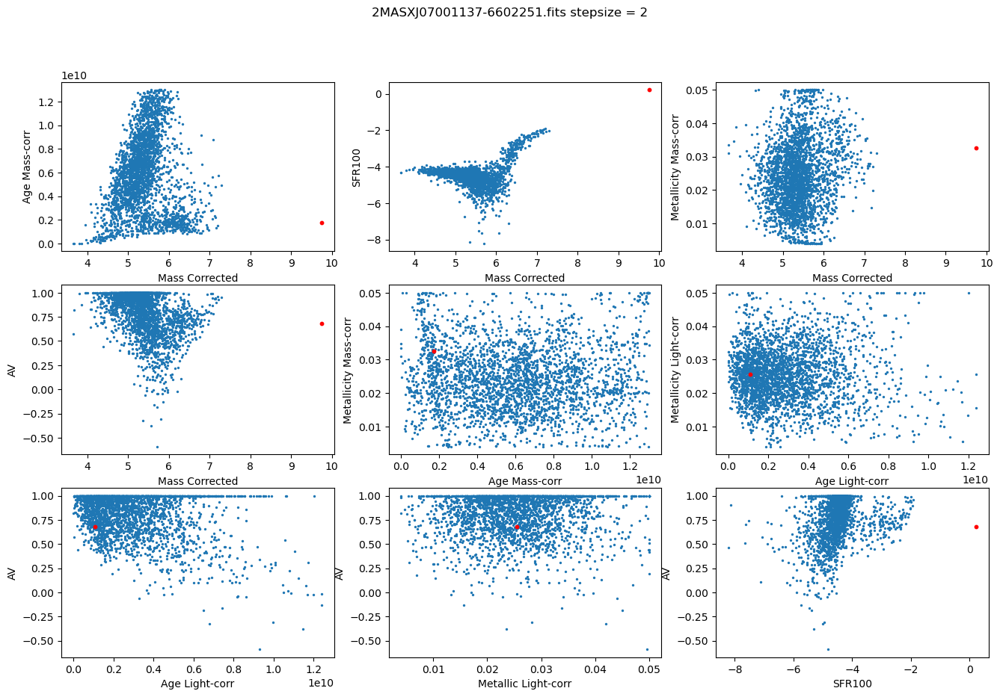

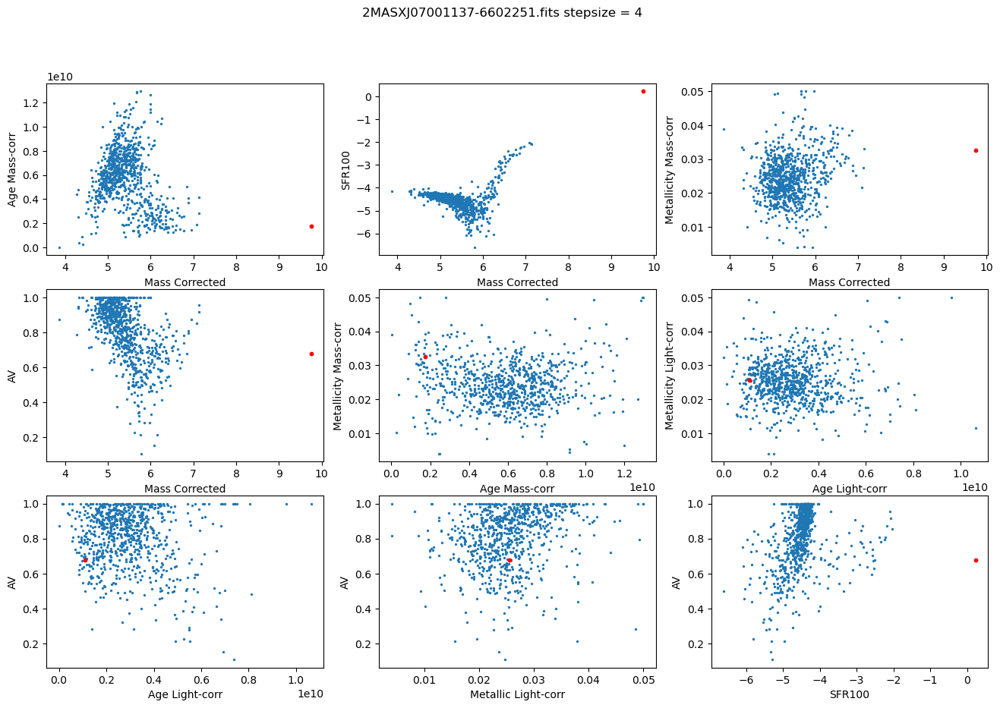

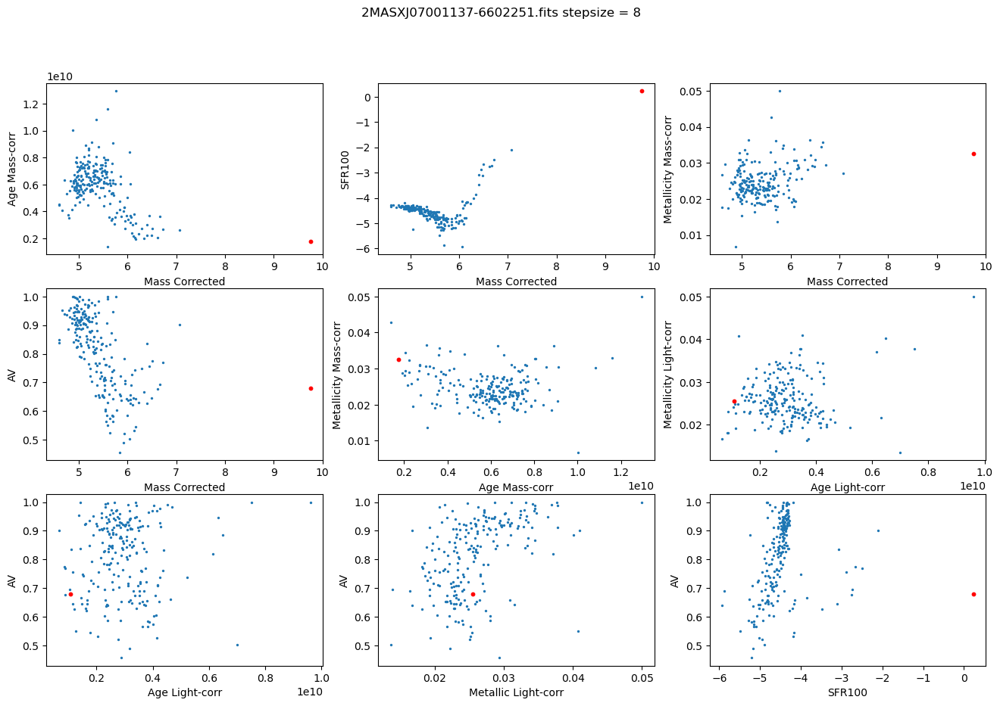

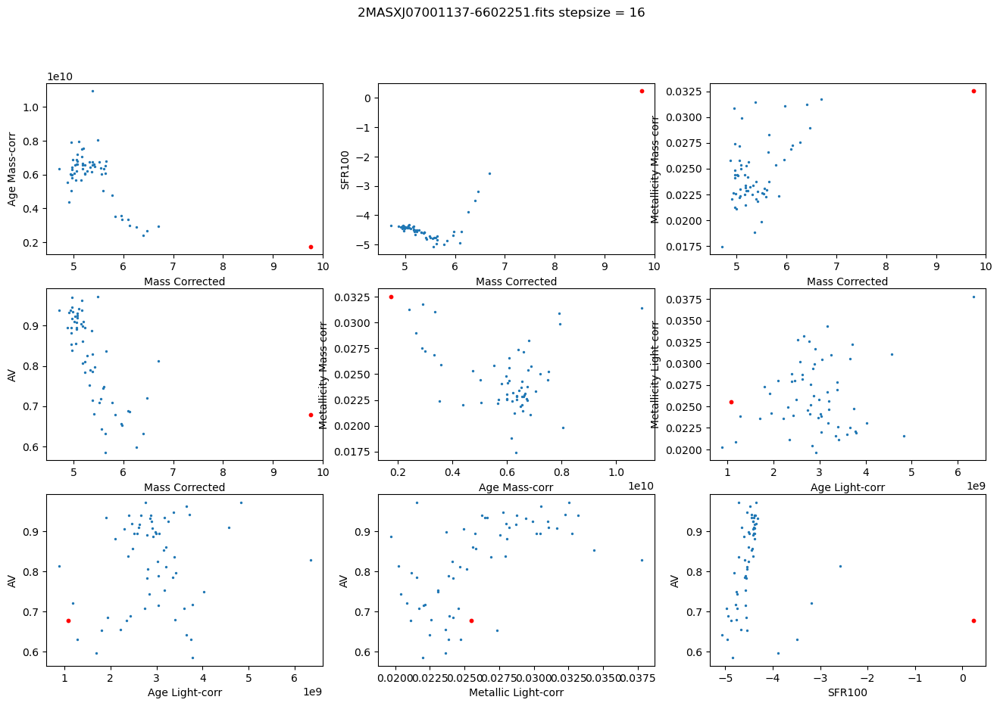

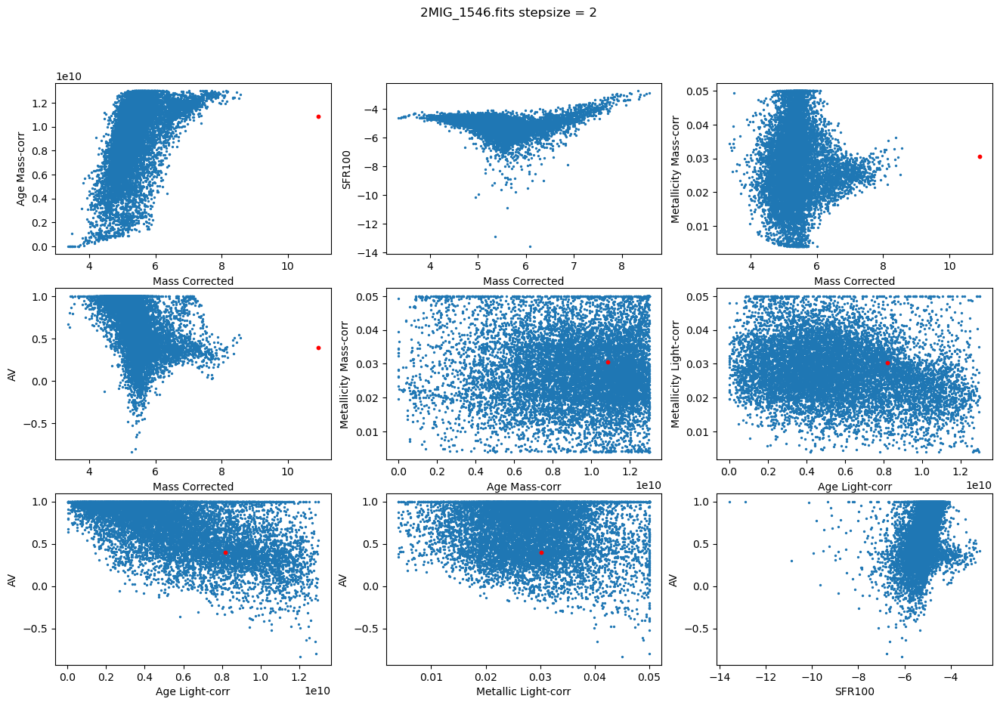

...

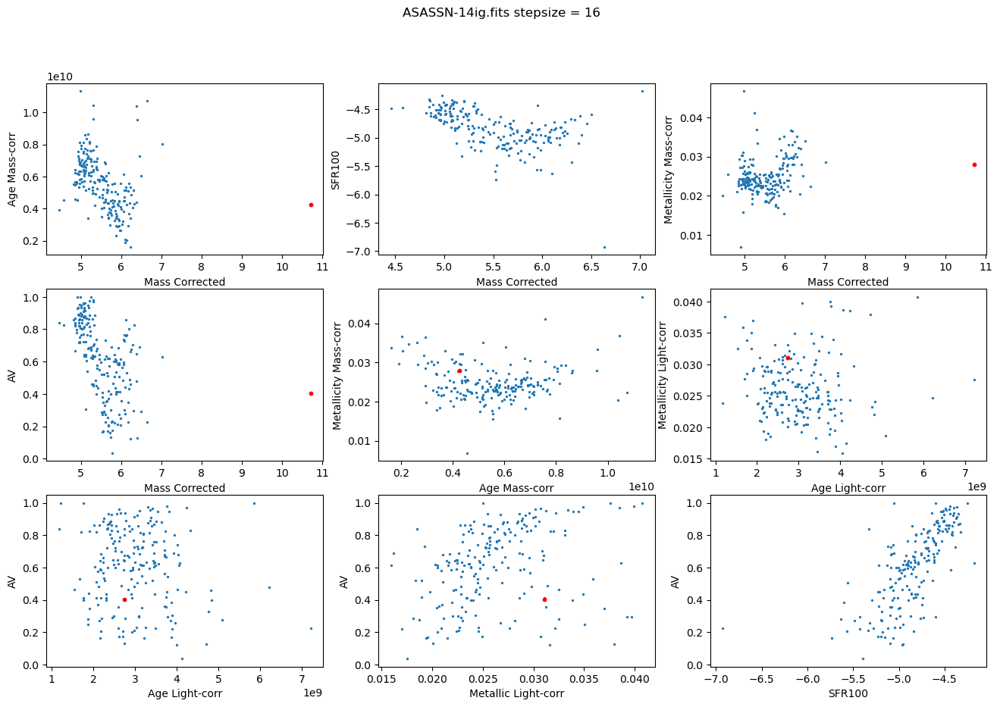

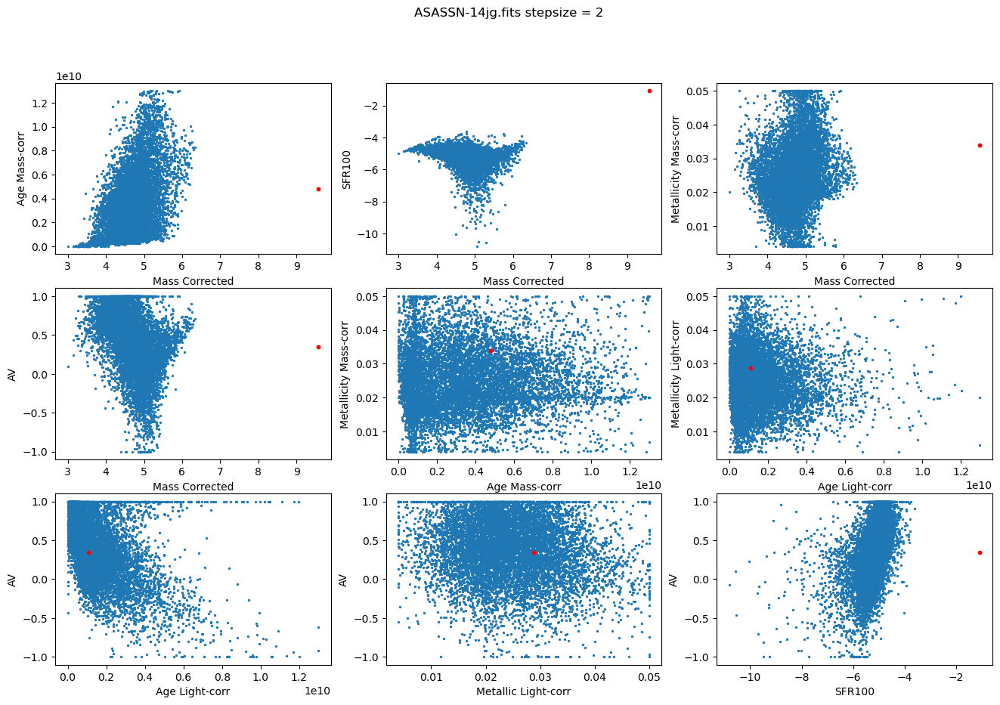

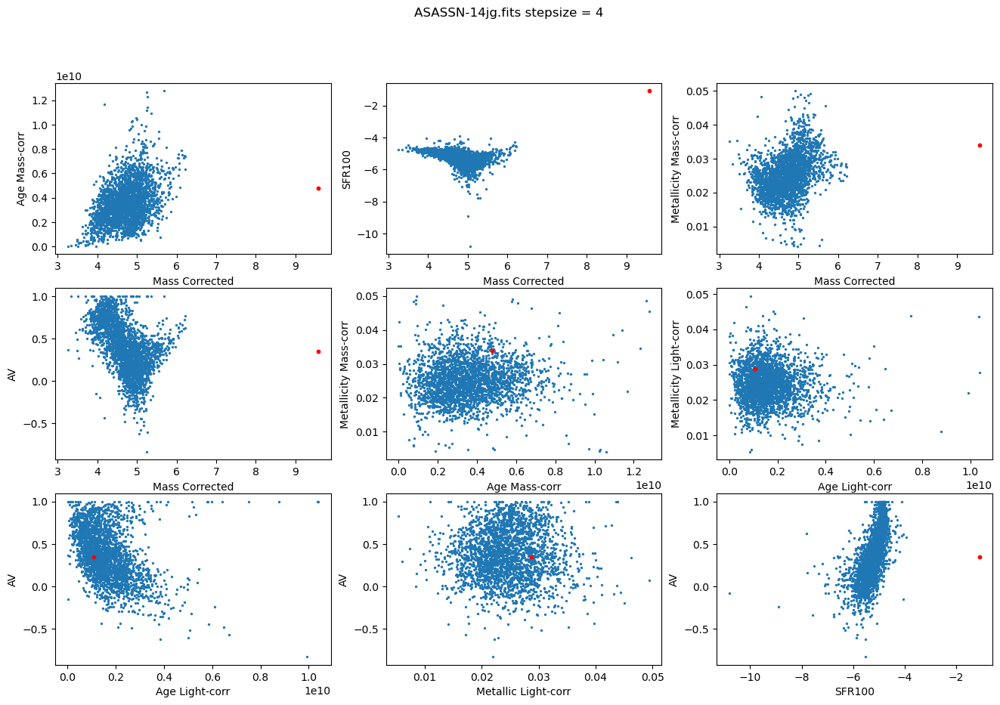

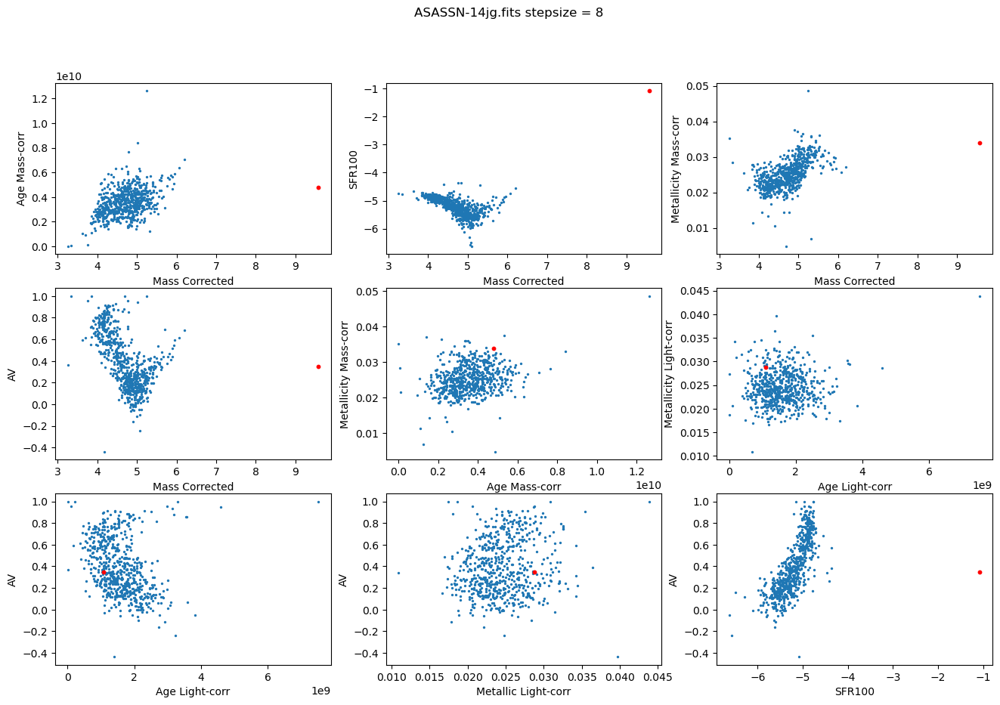

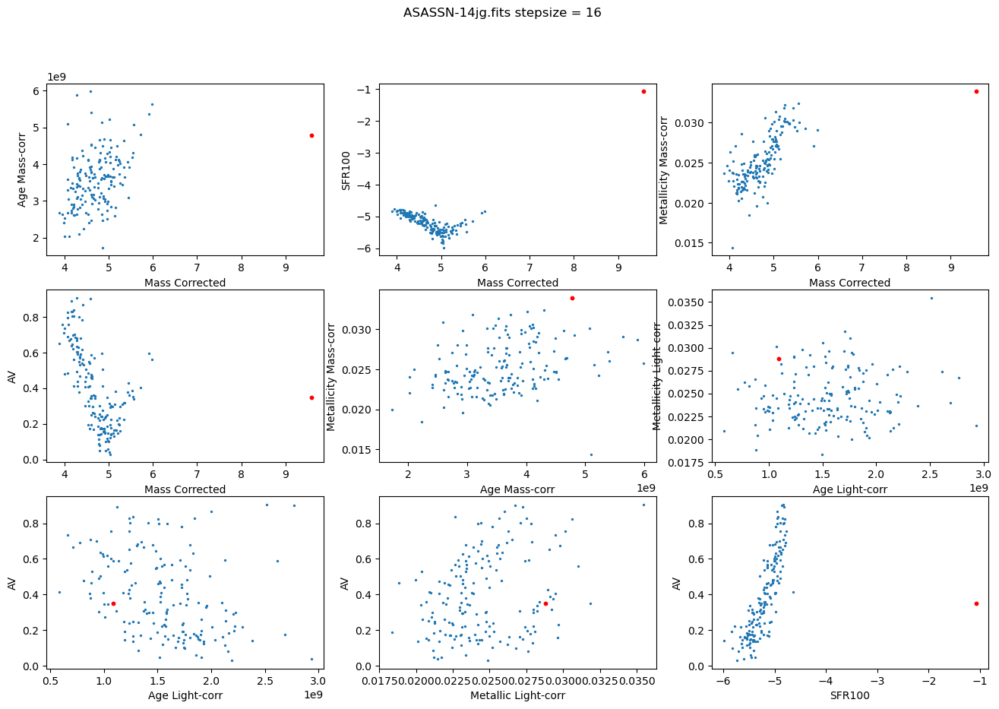

In [46]:
from astropy.io import fits
import numpy as np
from astropy.table import Table
import matplotlib.pyplot as plt
import pandas as pd

import os
current_directory = os.getcwd()
filenames = os.listdir(current_directory)

for i in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]:
    print(filenames[i])
    #Global Dataframe
    hdulg = fits.open('galaxies_global_imp.fits')
    dfg = Table(hdulg[1].data).to_pandas()

    #Local Dataframe
    hdul = fits.open(filenames[i])
    table = Table(hdul[1].data)
    df = table.to_pandas()
    df = df.sort_values(by=['position_x', 'position_y'])
    df.replace(-np.inf, np.nan, inplace=True)
    df.dropna(inplace=True)


    xmin = df.position_x.min()
    xmax = df.position_x.max()
    ymin= df.position_y.min()
    ymax= df.position_y.max()
    stepsize=[2,4,8,16]

    for j in range(len(stepsize)):
        # Create bins for x and y based on the specified range and step size
        x_bins = range(xmin, xmax+1, stepsize[j])
        y_bins = range(ymin, ymax+1, stepsize[j])

        # Group the DataFrame based on the bins for x and y
        grouped_df = df.groupby([pd.cut(df['position_x'], bins=x_bins), pd.cut(df['position_y'], bins=y_bins)])

        # Perform aggregations or apply functions to the grouped data as needed
        # For example, calculate the mean of a specific column
        mean_values = grouped_df[['Mass_ini', 'Mass_cor', 'SFR_10Myr',
               'SFR_100Myr', 'Age_LightWeighted', 'Age_MassWeighted',
               'Metallicity_LightWeighted', 'Metallicity_MassWeighted', 'A_V']].mean()

        #Local Parameters
        l_massc = np.array(mean_values['Mass_cor'])
        l_massi = np.array(mean_values['Mass_ini'])
        l_agem = np.array(mean_values['Age_MassWeighted'])
        l_agel = np.array(mean_values['Age_LightWeighted'])
        l_sfr10 = np.array(mean_values['SFR_10Myr'])
        l_sfr100 = np.array(mean_values['SFR_100Myr'])
        l_metm = np.array(mean_values['Metallicity_MassWeighted'])
        l_metl = np.array(mean_values['Metallicity_LightWeighted'])
        l_av = np.array(mean_values['A_V'])

        #Global Parameters
        g_massc = dfg.iloc[i-1]['Mass_cor']
        g_massi = dfg.iloc[i-1]['Mass_ini']
        g_agem = dfg.iloc[i-1]['Age_MassWeighted']
        g_agel = dfg.iloc[i-1]['Age_LightWeighted']
        g_sfr10 = dfg.iloc[i-1]['SFR_10Myr']
        g_sfr100 = dfg.iloc[i-1]['SFR_100Myr']
        g_metm = dfg.iloc[i-1]['Metallicity_MassWeighted']
        g_metl = dfg.iloc[i-1]['Metallicity_LightWeighted']
        g_av = dfg.iloc[i-1]['A_V']


        #PLOTTING
        fig, axs = plt.subplots(3, 3, figsize=(16,10))
        # Subplot 1
        axs[0, 0].scatter(l_massc, l_agem, s=2)
        axs[0, 0].scatter(g_massc, g_agem, c='r', s=10)
        axs[0, 0].set_xlabel('Mass Corrected')
        axs[0, 0].set_ylabel('Age Mass-corr')
        # Subplot 2
        axs[0, 1].scatter(l_massc, l_sfr100, s=2)
        axs[0, 1].scatter(g_massc, g_sfr100, c='r',s=10)
        axs[0, 1].set_xlabel('Mass Corrected')
        axs[0, 1].set_ylabel('SFR100')
        # Subplot 3
        axs[0, 2].scatter(l_massc, l_metm, s=2)
        axs[0, 2].scatter(g_massc, g_metm, c='r', s=10)
        axs[0, 2].set_xlabel('Mass Corrected')
        axs[0, 2].set_ylabel('Metallicity Mass-corr')
        # Subplot 4
        axs[1, 0].scatter(l_massc, l_av, s=2)
        axs[1, 0].scatter(g_massc, g_av, c='r', s=10)
        axs[1, 0].set_xlabel('Mass Corrected')
        axs[1, 0].set_ylabel('AV')
        # Subplot 5
        axs[1, 1].scatter(l_agem, l_metm, s=2)
        axs[1, 1].scatter(g_agem, g_metm, c='r', s=10)
        axs[1, 1].set_xlabel('Age Mass-corr')
        axs[1, 1].set_ylabel('Metallicity Mass-corr')
        # Subplot 6
        axs[1, 2].scatter(l_agel, l_metl, s=2)
        axs[1, 2].scatter(g_agel, g_metl, c='r', s=10)
        axs[1, 2].set_xlabel('Age Light-corr')
        axs[1, 2].set_ylabel('Metallicity Light-corr')
        # Subplot 7
        axs[2, 0].scatter(l_agel, l_av, s=2)
        axs[2, 0].scatter(g_agel, g_av, c='r', s=10)
        axs[2, 0].set_xlabel('Age Light-corr')
        axs[2, 0].set_ylabel('AV')
        # Subplot 8
        axs[2, 1].scatter(l_metl, l_av, s=2)
        axs[2, 1].scatter(g_metl, g_av, c='r', s=10)
        axs[2, 1].set_xlabel('Metallic Light-corr')
        axs[2, 1].set_ylabel('AV')
        # Subplot 9
        axs[2, 2].scatter(l_sfr100, l_av, s=2)
        axs[2, 2].scatter(g_sfr100, g_av, c='r', s=10)
        axs[2, 2].set_xlabel('SFR100')
        axs[2, 2].set_ylabel('AV')
        fig.suptitle(f'{filenames[i]} stepsize = {stepsize[j]}')
        plt.savefig(f'Figures/{filenames[i]}_stepsize{stepsize[j]}.png')